In [1]:
cd TileEM/

/Users/dorislee/Desktop/Research/seg/crowd-seg/analysis/TileEM


In [2]:
%pylab inline
%load_ext autoreload
%autoreload 2
from TileEM_plot_toolbox import *

Populating the interactive namespace from numpy and matplotlib


In [3]:
cd step500_output/

/Users/dorislee/Desktop/Research/seg/crowd-seg/analysis/TileEM/step500_output


In [4]:
object_lst = list(object_tbl.id)

In [91]:
def compute_PR_obj(objid,experiment_idx,threshold=-1,topk=-1,majority_topk=-1,PLOT_HEATMAP=False):
    '''
    Compute the precision recall for a object indexed by objid
    based on T-search strategy indexed by experiment_idx, where:
    0 = Avrg 
    1 = Median
    2 = Local Search
    3 = Exhaustive Search
    The post-processing method could either be gamma threshold, top-k gamma, or top-k majority vote.
    OPTIONAL: Plot Gamma Heatmap 
    '''
    
    precision_lst = []
    recall_lst = []
    try:
        tiles = pkl.load(open("tiles{}.pkl".format(objid),'r'))
        gammas = pkl.load(open("gfile{}.pkl".format(objid),'r'))#ga,gm,gl,ge
        # Deriving new solution set from different thresholding criteria
        if majority_topk==-1:
            if threshold!=-1:
                procstr = "Gamma>{}".format(threshold)
                solnset = getSolutionThreshold(gammas[experiment_idx],threshold=threshold)
            elif topk!=-1:
                procstr="Gamma k={}".format(k)
                solnset = getSolutionTopK(gammas[experiment_idx],k=topk)
        elif majority_topk!=-1:
            os.chdir("..")
            tiles, objIndicatorMat = createObjIndicatorMatrix(objid,sampleNworkers=40,PRINT=False)
            os.chdir("step500_output")
            worker_tile_votes = np.sum(objIndicatorMat,axis=1)[:-1] 
            procstr="Majority k={}".format(k)
            solnset = getSolutionTopK(worker_tile_votes,k=majority_topk)
        if PLOT_HEATMAP: 
            mask = plot_tile_gamma(objid,solnset ,tiles,gammas[experiment_idx],PLOT_BBG=True,PLOT_GSOLN=True)
        precision,recall = compute_PR(objid,solnset,tiles)
        font0 = matplotlib.font_manager.FontProperties()
        font1=font0.copy()
        font1.set_size('xx-large')
        font1.set_weight('heavy')
        plt.figtext(0.45,0.7,'{0}\n P={1:.2f}, R={2:.2f}'.format(procstr,precision,recall),color='white',fontproperties=font1,ha='center')
    except(IOError):
        pass
    return precision,recall


lower the threshold list to 10 steps , of 0.1 each because there is a limited number of things in the solution set so changing the threshold really doesn't actually change that much. 

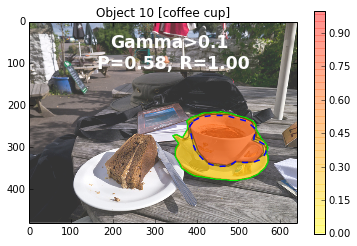

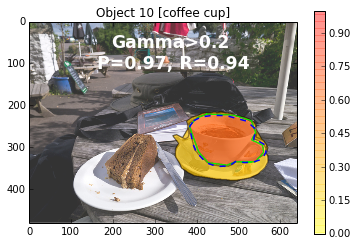

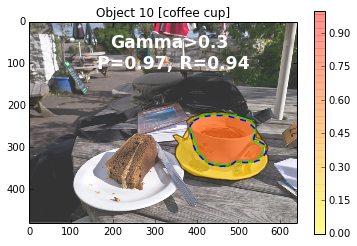

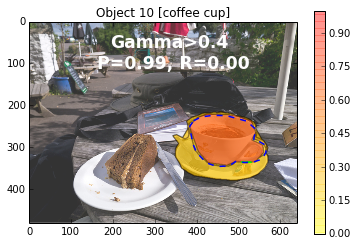

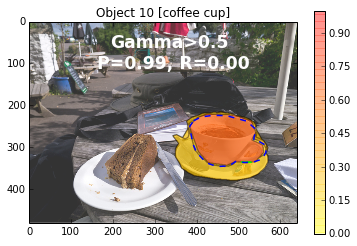

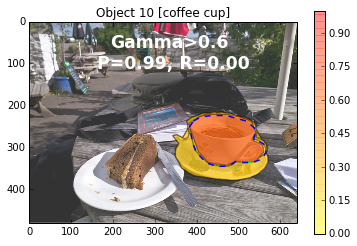

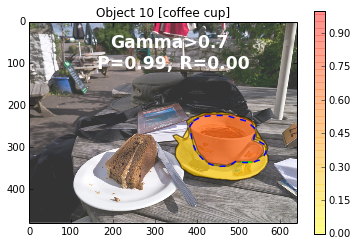

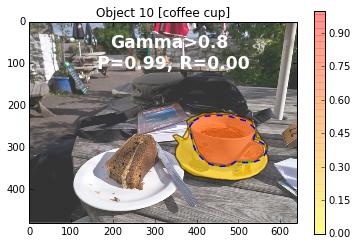

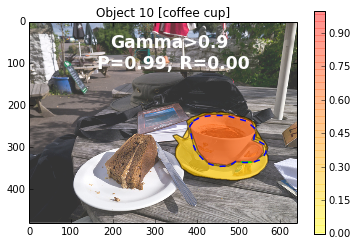

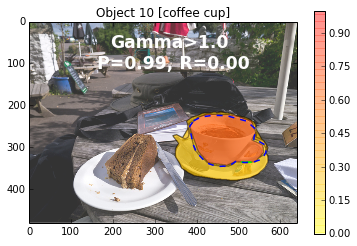

In [92]:
threshold_lst = np.linspace(0.1,1,10)
for threshold in threshold_lst:
    p,r = compute_PR_obj(10,0,threshold=threshold,PLOT_HEATMAP=True)

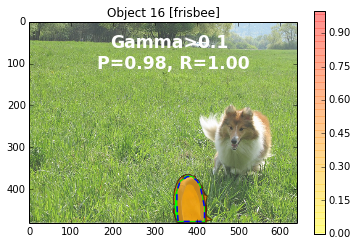

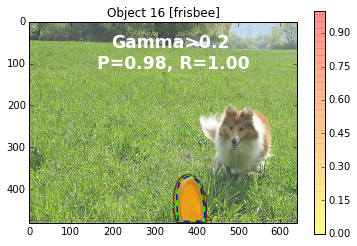

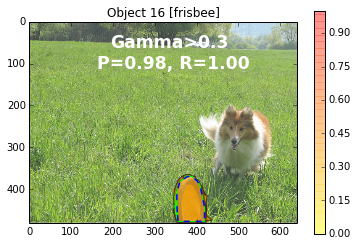

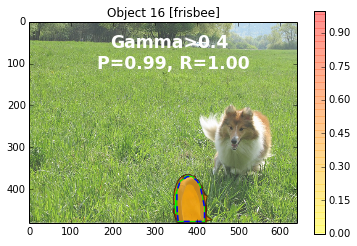

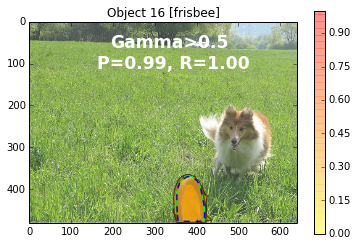

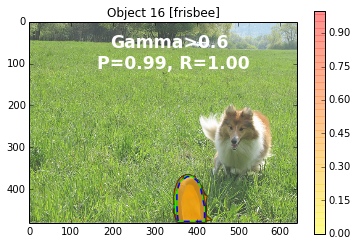

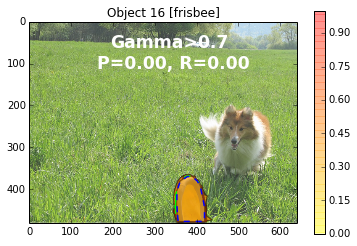

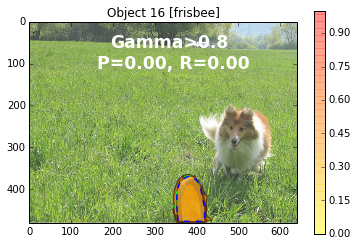

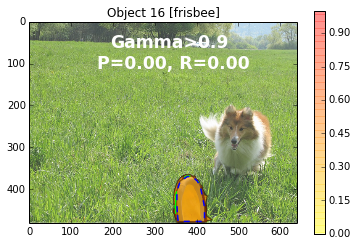

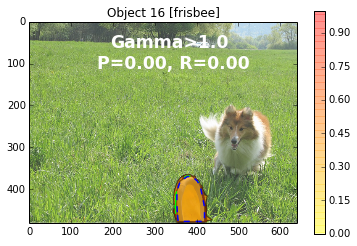

In [93]:
for threshold in threshold_lst:
    p,r = compute_PR_obj(16,0,threshold=threshold,PLOT_HEATMAP=True)

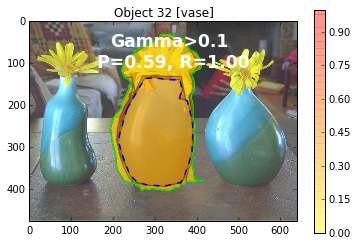

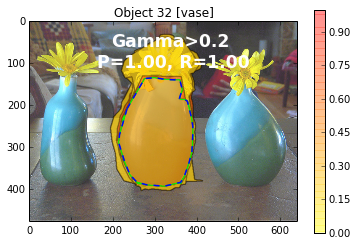

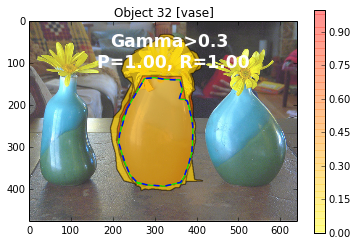

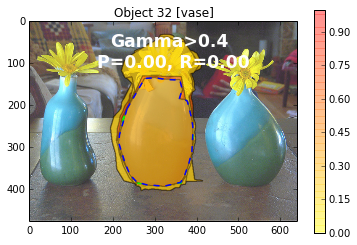

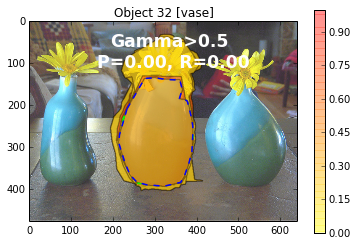

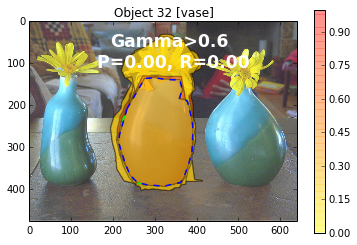

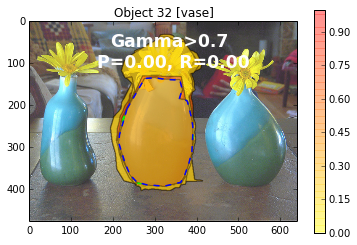

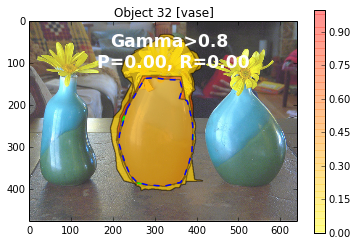

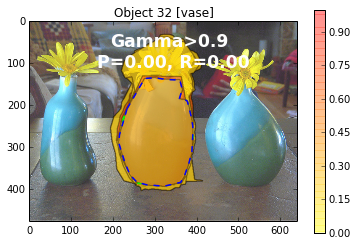

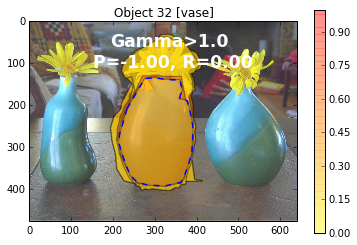

In [94]:
for threshold in threshold_lst:
    p,r = compute_PR_obj(32,0,threshold=threshold,PLOT_HEATMAP=True)

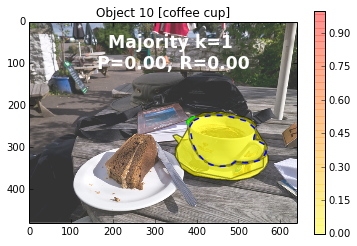

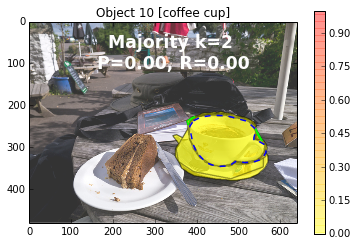

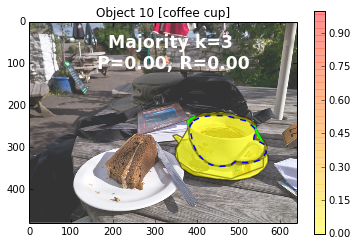

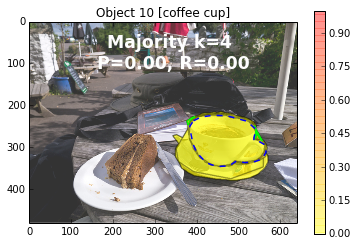

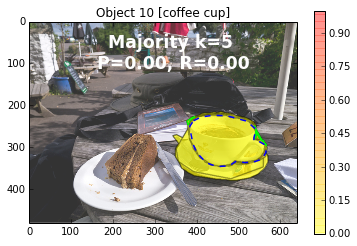

...

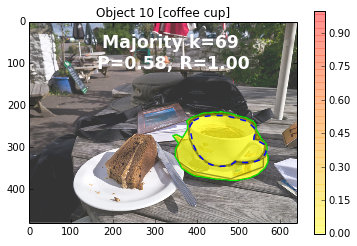

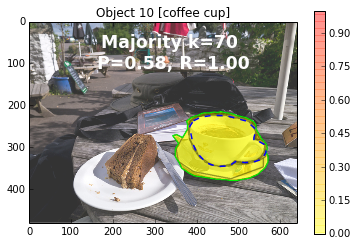

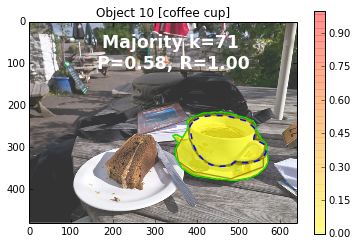

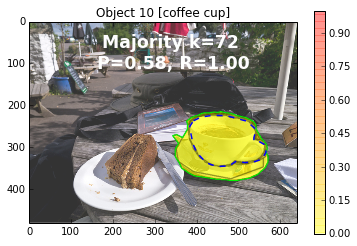

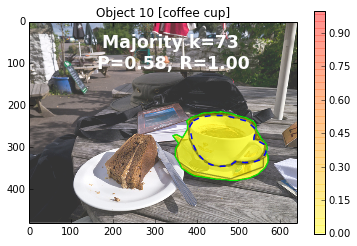

In [113]:
objid=10
os.chdir("..")
tiles, objIndicatorMat = createObjIndicatorMatrix(objid,sampleNworkers=40,PRINT=False)
os.chdir("step500_output")
k_lst = np.arange(1,len(tiles))
for k in k_lst:
    p,r = compute_PR_obj(10,0,majority_topk=k,PLOT_HEATMAP=True)

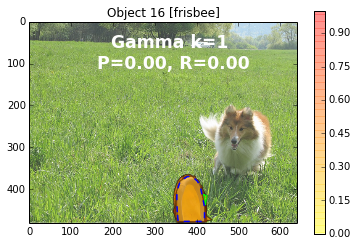

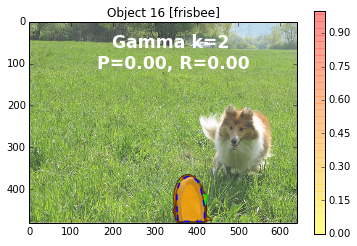

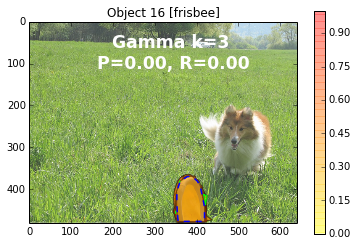

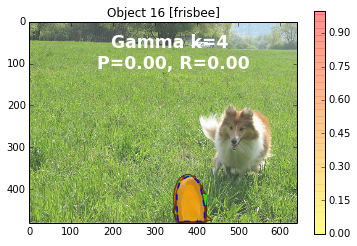

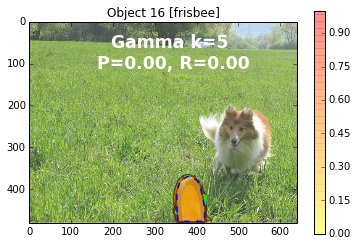

...

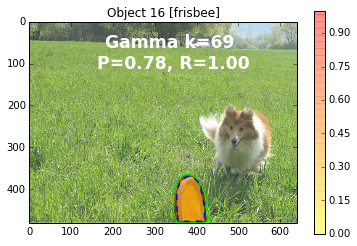

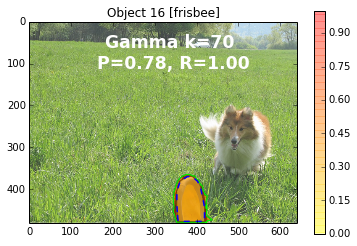

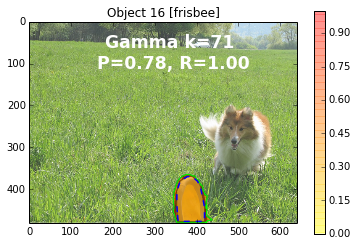

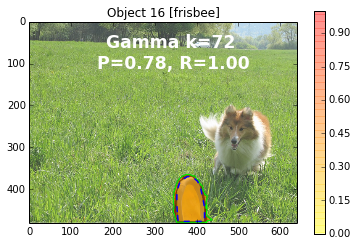

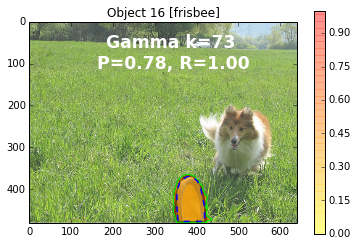

In [96]:
for k in k_lst:
    p,r = compute_PR_obj(16,0,topk=k,PLOT_HEATMAP=True)

In [7]:
# plot_all_obj_tiles(1,threshold=0.5)
# plot_all_obj_tiles(2,threshold=0.5)
# plot_all_obj_tiles(3,threshold=0.5)

adaptive file writing 

In [103]:
f = open("likelihood1.txt",'w')

In [104]:
f.close()

In [111]:
import glob
existedIdx = int(glob.glob("likelihood*.txt")[-1].split(".")[0][-1])

In [112]:
existedIdx+1

2